# Echo State Network as a tunable frequency generator

This is a simplified implementation of Herbert Jaeger's task of learning a simple non-autonomous system, [a frequency generator controlled by an external signal](http://www.scholarpedia.org/article/Echo_state_network). Plots at the end.

[See the ESN implementation](https://github.com/cknd/pyESN).


This one just changed the default reservoir size to be 32 instead of 200.

In [1]:
import os 
os.chdir('..')
print("The current workding directory:", os.getcwd())

The current workding directory: /Users/sungjae/Projects/pyESN


In [1]:
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
from pyESN import ESN
from dataset.freq2wav import frequency_generator
from tqdm import tqdm

## Task

The network will learn to generate a wave signal whose frequency is determined by some slowly changing control input.

### 1) Generate some sample data: 3 datasets
1. Training and test sets varing frequency control input
1. Test set of a fixed frequency control input
1. Test set of a fixed frequency control input

#### 1.1) Dataset 1

In [2]:
randomstate = np.random.RandomState(42)

N = 15000 # signal length
min_period = 10 #[OriginalCode] 2
max_period = 18 #[OriginalCode] 10
n_changepoints = int(N/200)
frequency_control,frequency_output = frequency_generator(N,min_period,max_period,n_changepoints,randomstate)

traintest_cutoff = int(np.ceil(0.7*N))

train_ctrl, train_output = frequency_control[:traintest_cutoff],frequency_output[:traintest_cutoff]
test_ctrl, test_output  = frequency_control[traintest_cutoff:],frequency_output[traintest_cutoff:]

print("train_ctrl.shape", train_ctrl.shape)
print("train_output.shape", train_output.shape)
print("test_ctrl.shape", test_ctrl.shape)
print("test_output.shape", test_output.shape)

train_ctrl.shape (10500, 2)
train_output.shape (10500, 1)
test_ctrl.shape (4500, 2)
test_output.shape (4500, 1)


#### 1.2) Dataset 2

In [3]:
randomstate = np.random.RandomState(42)

N = 15000 # signal length
min_period = 10 #[OriginalCode] 2
max_period = 18 #[OriginalCode] 10
n_changepoints = 0
easy_frequency_control, easy_frequency_output = frequency_generator(N,min_period,max_period,n_changepoints,randomstate)

traintest_cutoff = int(np.ceil(0.7*N))

easy_train_ctrl, easy_train_output = easy_frequency_control[:traintest_cutoff],frequency_output[:traintest_cutoff]
easy_test_ctrl, easy_test_output  = easy_frequency_control[traintest_cutoff:],frequency_output[traintest_cutoff:]

print("easy_train_ctrl.shape", easy_train_ctrl.shape)
print("easy_train_output.shape", easy_train_output.shape)
print("easy_test_ctrl.shape", easy_test_ctrl.shape)
print("easy_test_output.shape", easy_test_output.shape)

easy_train_ctrl.shape (10500, 2)
easy_train_output.shape (10500, 1)
easy_test_ctrl.shape (4500, 2)
easy_test_output.shape (4500, 1)


In [4]:
easy_test_ctrl

array([[1.        , 0.62545988],
       [1.        , 0.62545988],
       [1.        , 0.62545988],
       ...,
       [1.        , 0.62545988],
       [1.        , 0.62545988],
       [1.        , 0.62545988]])

#### 1.3) Dataset 3

In [5]:
randomstate = np.random.RandomState(73)

N = 15000 # signal length
min_period = 10 #[OriginalCode] 2
max_period = 18 #[OriginalCode] 10
n_changepoints = 0
easy2_frequency_control, easy2_frequency_output = frequency_generator(N,min_period,max_period,n_changepoints,randomstate)

traintest_cutoff = int(np.ceil(0.7*N))

easy2_train_ctrl, easy2_train_output = easy2_frequency_control[:traintest_cutoff],frequency_output[:traintest_cutoff]
easy2_test_ctrl, easy2_test_output  = easy2_frequency_control[traintest_cutoff:],frequency_output[traintest_cutoff:]

print("easy2_train_ctrl.shape", easy2_train_ctrl.shape)
print("easy2_train_output.shape", easy2_train_output.shape)
print("easy2_test_ctrl.shape", easy2_test_ctrl.shape)
print("easy2_test_output.shape", easy2_test_output.shape)

easy2_train_ctrl.shape (10500, 2)
easy2_train_output.shape (10500, 1)
easy2_test_ctrl.shape (4500, 2)
easy2_test_output.shape (4500, 1)


### 2) Instantiate, train & test the network
Parameters are mostly the same as in Herbert Jaeger's original Matlab code. 

#### 2.0. Setting helpers for experiments

##### 2.0.1. Default hyperparameters

In [6]:
# Default parameters given in https://github.com/cknd/pyESN
# Only n_reservoir is changed from 200 to 32.
init_params = {
    'n_inputs' : 2,
    'n_outputs' : 1,
    'n_reservoir' : 32,
    'spectral_radius' : 0.25,
    'sparsity' : 0.95,
    'noise' : 0.001,
    'input_shift' : [0,0],
    'input_scaling' : [0.01, 3],
    'teacher_scaling' : 1.12,
    'teacher_shift' : -0.7,
    'out_activation' : np.tanh,
    'inverse_out_activation' : np.arctanh,
    'random_state' : randomstate,
    'silent' : True,
    'concat_input2state' : False
}
params = init_params.copy()

##### 2.0.2. Helper for hyperparameter initialization

In [7]:
# Initialize ESN with the given parameters
def init_ESN(params):
    esn = ESN(n_inputs = params['n_inputs'],
              n_outputs = params['n_outputs'],
              n_reservoir = params['n_reservoir'],
              spectral_radius = params['spectral_radius'],
              sparsity = params['sparsity'],
              noise = params['noise'],
              input_shift = params['input_shift'],
              input_scaling = params['input_scaling'],
              teacher_scaling = params['teacher_scaling'],
              teacher_shift = params['teacher_shift'],
              out_activation = params['out_activation'],
              inverse_out_activation = params['inverse_out_activation'],
              random_state = params['random_state'],
              silent = params['silent'],
              concat_input2state = params['concat_input2state'])
    return esn

##### 2.0.3. Helper for hyperparameter search

In [17]:
def run_ESN(params, train_ctrl, train_output, test_ctrl, test_output):
    esn = ESN(n_inputs = params['n_inputs'],
              n_outputs = params['n_outputs'],
              n_reservoir = params['n_reservoir'],
              spectral_radius = params['spectral_radius'],
              sparsity = params['sparsity'],
              noise = params['noise'],
              input_shift = params['input_shift'],
              input_scaling = params['input_scaling'],
              teacher_scaling = params['teacher_scaling'],
              teacher_shift = params['teacher_shift'],
              out_activation = params['out_activation'],
              inverse_out_activation = params['inverse_out_activation'],
              random_state = params['random_state'],
              silent = params['silent'],
              concat_input2state = params['concat_input2state'])

    pred_train, train_error = esn.fit(train_ctrl,train_output)

    pred_test = esn.predict(test_ctrl)
    test_error = np.sqrt(np.mean((pred_test - test_output)**2))
    return pred_train, train_error, pred_test, test_error

#### 2.1. Reservoir size 

SKIP!!! Already done! Reservoir size 32 is a nearly minimal size.

#### 2.2. Sparsity

In [9]:
params = init_params.copy()

In [19]:
sparsity_list = list()
train_errors = list()
test_errors = list()
for sparsity in tqdm(np.arange(0,1.0,0.01)):
    params['sparsity'] = sparsity
    try:
        pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    except:
        continue
    sparsity_list.append(sparsity)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 100/100 [00:18<00:00,  5.33it/s]


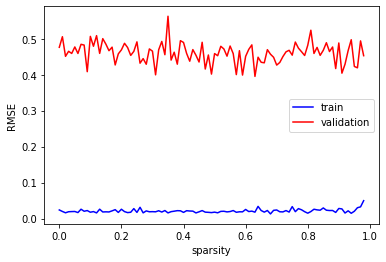

In [20]:
plt.plot(sparsity_list, train_errors, color='blue', label='train')
plt.plot(sparsity_list, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('sparsity')
plt.ylabel('RMSE')

plt.show()

In [21]:
# Try different random seed
params = init_params.copy()
params['random_state'] = np.random.RandomState(73)

In [22]:
sparsity_list = list()
train_errors = list()
test_errors = list()
for sparsity in tqdm(np.arange(0,1.0,0.01)):
    params['sparsity'] = sparsity
    try:
        pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    except:
        continue
    sparsity_list.append(sparsity)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 100/100 [00:18<00:00,  5.31it/s]


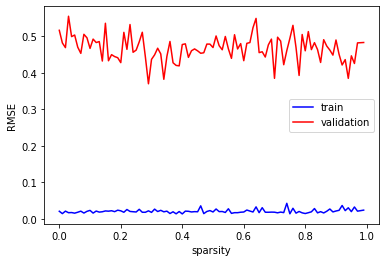

In [23]:
plt.plot(sparsity_list, train_errors, color='blue', label='train')
plt.plot(sparsity_list, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('sparsity')
plt.ylabel('RMSE')

plt.show()

#### 2.3. Input scaling

#### 2.3.1. Input scaling same for weights and biases

In [58]:
params = init_params.copy()

In [59]:
input_scales = list()
train_errors = list()
test_errors = list()
for input_scale in tqdm(np.arange(0.01,5,0.01)):
    params['input_scaling'] = [input_scale, input_scale]
    try:
        pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    except:
        pass
    input_scales.append(input_scale)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 499/499 [00:00<00:00, 756126.34it/s]


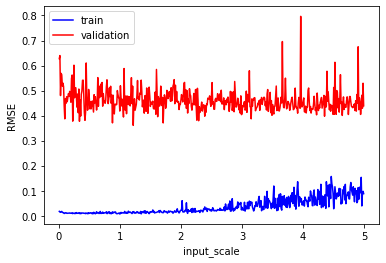

In [46]:
plt.plot(input_scales, train_errors, color='blue', label='train')
plt.plot(input_scales, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('input_scale')
plt.ylabel('RMSE')

plt.show()

#### 2.3.2. Input scaling search only for weights

In [15]:
params = init_params.copy()

In [20]:
input_scales = list()
train_errors = list()
test_errors = list()
for input_scale in tqdm(np.arange(0.01,5,0.01)):
    params['input_scaling'] = [init_params['input_scaling'][0], input_scale]
    try:
        pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    except:
        pass
    input_scales.append(input_scale)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 499/499 [01:32<00:00,  5.39it/s]


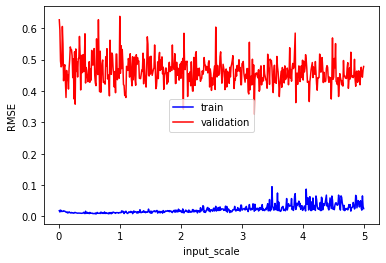

In [21]:
plt.plot(input_scales, train_errors, color='blue', label='train')
plt.plot(input_scales, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('input_scale')
plt.ylabel('RMSE')

plt.show()

#### 2.3.3. Input scaling search only for biases

In [47]:
input_scales = list()
train_errors = list()
test_errors = list()
for input_scale in tqdm(np.arange(0.01,5,0.01)):
    params['input_scaling'] = [input_scale, init_params['input_scaling'][1]]
    try:
        pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    except:
        pass
    input_scales.append(input_scale)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 499/499 [01:33<00:00,  5.35it/s]


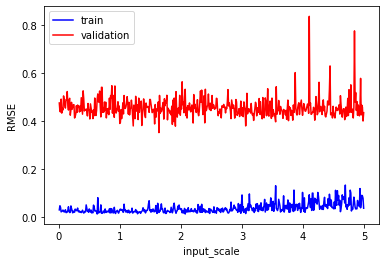

In [48]:
plt.plot(input_scales, train_errors, color='blue', label='train')
plt.plot(input_scales, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('input_scale')
plt.ylabel('RMSE')

plt.show()

#### 2.3.3. Input scaling search only for biases (near 0.01: default bias input scaling)

In [49]:
input_scales = list()
train_errors = list()
test_errors = list()
for input_scale in tqdm(np.arange(0.001,0.03,0.001)):
    params['input_scaling'] = [input_scale, init_params['input_scaling'][1]]
    try:
        pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    except:
        pass
    input_scales.append(input_scale)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 29/29 [00:05<00:00,  5.33it/s]


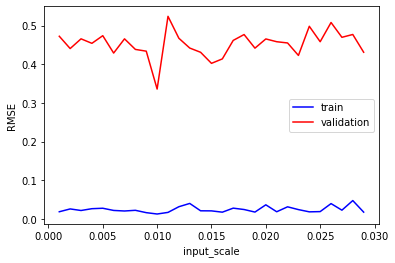

In [50]:
plt.plot(input_scales, train_errors, color='blue', label='train')
plt.plot(input_scales, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('input_scale')
plt.ylabel('RMSE')

plt.show()

In [25]:
params = init_params.copy()

In [26]:
input_scales = list()
train_errors = list()
test_errors = list()
for input_scale in tqdm(np.arange(0.01,5,0.01)):
    try:
        pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    except:
        pass
    input_scales.append(input_scale)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 499/499 [01:33<00:00,  5.35it/s]


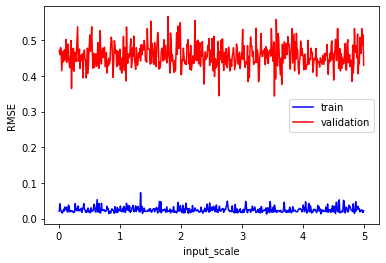

In [27]:
plt.plot(input_scales, train_errors, color='blue', label='train')
plt.plot(input_scales, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('input_scale')
plt.ylabel('RMSE')

plt.show()

#### 2.4. Spectral radius

In [28]:
params = init_params.copy()

In [29]:
spectral_radius_list = list()
train_errors = list()
test_errors = list()
for spectral_radius in tqdm(np.arange(0.01,2,0.01)):
    params['spectral_radius'] = spectral_radius
    pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    spectral_radius_list.append(spectral_radius)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 199/199 [00:37<00:00,  5.35it/s]


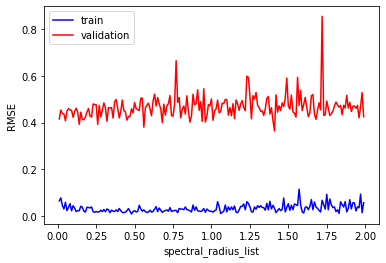

In [30]:
plt.plot(spectral_radius_list, train_errors, color='blue', label='train')
plt.plot(spectral_radius_list, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('spectral_radius_list')
plt.ylabel('RMSE')

plt.show()

##### Try different random seed

In [31]:
# Try different random seed
params = init_params.copy()
params['random_state'] = np.random.RandomState(73)

In [33]:
spectral_radius_list = list()
train_errors = list()
test_errors = list()
for spectral_radius in tqdm(np.arange(0.01,2,0.01)):
    params['spectral_radius'] = spectral_radius
    try:
        pred_train, train_error, pred_test, test_error = run_ESN(params, train_ctrl, train_output, test_ctrl, test_output)
    except:
        pass
    spectral_radius_list.append(spectral_radius)
    train_errors.append(train_error)
    test_errors.append(test_error)

100%|██████████| 199/199 [00:37<00:00,  5.34it/s]


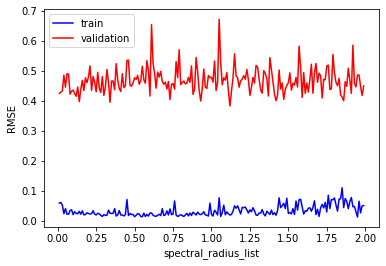

In [34]:
plt.plot(spectral_radius_list, train_errors, color='blue', label='train')
plt.plot(spectral_radius_list, test_errors, color='red', label='validation')
plt.legend()
plt.xlabel('spectral_radius_list')
plt.ylabel('RMSE')

plt.show()

#### 3) Plots
First, a look at the control signal, the target signal and the output of the model both during training and during testing.

In [25]:
def draw_spectogram(data):
    plt.specgram(data,Fs=4,NFFT=256,noverlap=150,cmap=plt.cm.bone,detrend=lambda x:(x-0.5))
    plt.gca().autoscale('x')
    plt.ylim([0,0.5])
    plt.ylabel("freq")
    plt.yticks([])
    plt.xlabel("time")
    plt.xticks([])

train_error
0.006777283122388812
test_error
0.5050630639789686


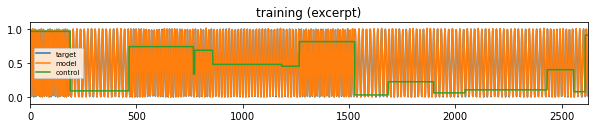

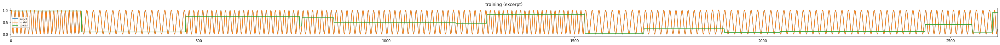

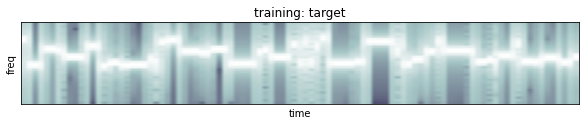

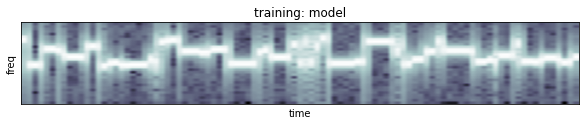

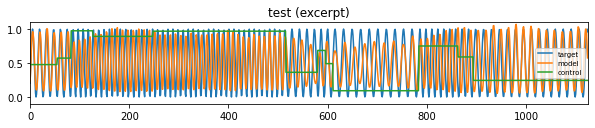

...

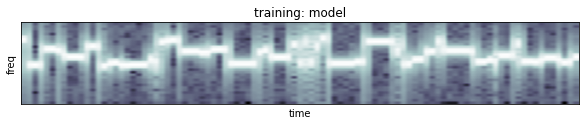

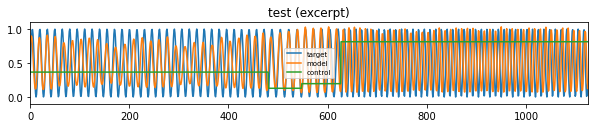

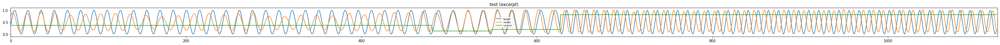

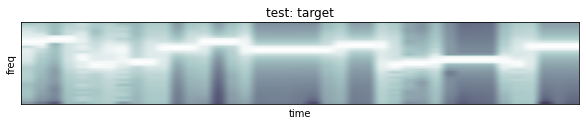

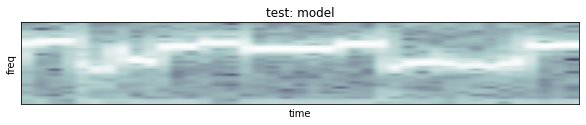

In [26]:
params = init_params.copy()
params['n_reservoir'] = 200

esn = init_ESN(params)
pred_train, train_error = esn.fit(train_ctrl,train_output)
pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))

print("train_error")
print(train_error)
print("test_error")
print(test_error)

n_segments = 4
for i_seg in range(n_segments):
    window_tr = range(int(len(train_output)/n_segments*i_seg),int(len(train_output)/n_segments*(1+i_seg)))
    plt.figure(figsize=(10,1.5))
    plt.plot(train_output[window_tr],label='target')
    plt.plot(pred_train[window_tr],label='model')
    plt.plot(train_ctrl[window_tr,1],label='control')
    plt.legend(fontsize='x-small')
    plt.title('training (excerpt)')
    plt.xlim([0,len(window_tr)])
    plt.ylim([-0.1,1.1])
    
    plt.figure(figsize=(50,1.5))
    plt.plot(train_output[window_tr],label='target')
    plt.plot(pred_train[window_tr],label='model')
    plt.plot(train_ctrl[window_tr,1],label='control')
    plt.legend(fontsize='x-small')
    plt.title('training (excerpt)')
    plt.xlim([0,len(window_tr)])
    plt.ylim([-0.1,1.1])
    
    plt.figure(figsize=(10,1.5))
    draw_spectogram(train_output.flatten())
    plt.title("training: target")
    plt.figure(figsize=(10,1.5))
    draw_spectogram(pred_train.flatten())
    plt.title("training: model")
    
    window_test = range(int(len(test_output)/n_segments*i_seg),int(len(test_output)/n_segments*(1+i_seg)))
    plt.figure(figsize=(10,1.5))
    plt.plot(test_output[window_test],label='target')
    plt.plot(pred_test[window_test],label='model')
    plt.plot(test_ctrl[window_test,1],label='control')
    plt.legend(fontsize='x-small')
    plt.title('test (excerpt)')
    plt.xlim([0,len(window_test)])
    plt.ylim([-0.1,1.1]);
    
    plt.figure(figsize=(50,1.5))
    plt.plot(test_output[window_test],label='target')
    plt.plot(pred_test[window_test],label='model')
    plt.plot(test_ctrl[window_test,1],label='control')
    plt.legend(fontsize='x-small')
    plt.title('test (excerpt)')
    plt.xlim([0,len(window_test)])
    plt.ylim([-0.1,1.1]);
    
    plt.figure(figsize=(10,1.5))
    draw_spectogram(test_output.flatten())
    plt.title("test: target")
    plt.figure(figsize=(10,1.5))
    draw_spectogram(pred_test.flatten())
    plt.title("test: model")
    
    plt.show()

train_error
0.025318692920811393
test_error
0.42486079423387685


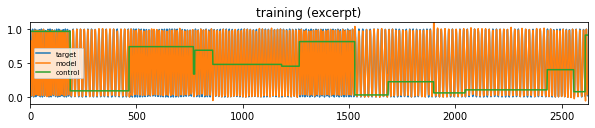

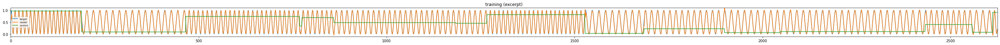

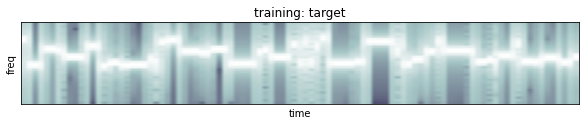

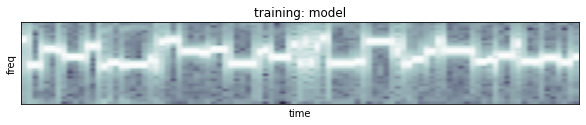

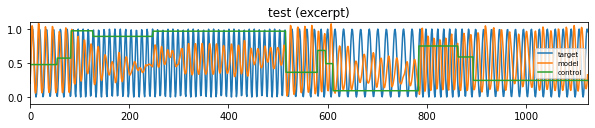

...

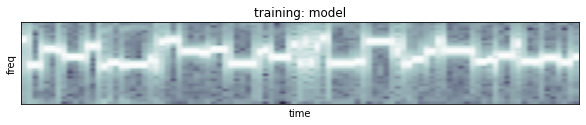

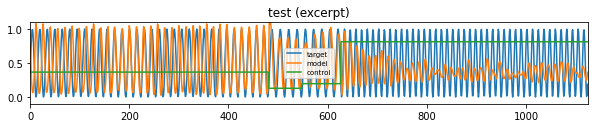

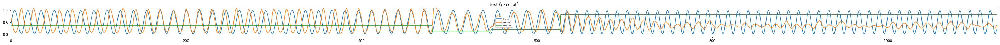

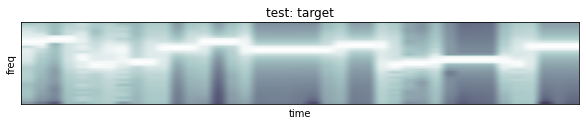

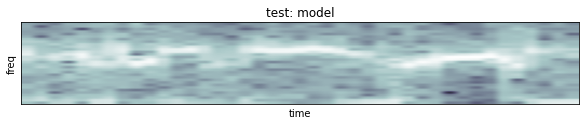

In [30]:
params = init_params.copy()
params['n_reservoir'] = 32

esn = init_ESN(params)
pred_train, train_error = esn.fit(train_ctrl,train_output)
pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))

print("train_error")
print(train_error)
print("test_error")
print(test_error)

n_segments = 4
for i_seg in range(n_segments):
    window_tr = range(int(len(train_output)/n_segments*i_seg),int(len(train_output)/n_segments*(1+i_seg)))
    plt.figure(figsize=(10,1.5))
    plt.plot(train_output[window_tr],label='target')
    plt.plot(pred_train[window_tr],label='model')
    plt.plot(train_ctrl[window_tr,1],label='control')
    plt.legend(fontsize='x-small')
    plt.title('training (excerpt)')
    plt.xlim([0,len(window_tr)])
    plt.ylim([-0.1,1.1])
    
    plt.figure(figsize=(50,1.5))
    plt.plot(train_output[window_tr],label='target')
    plt.plot(pred_train[window_tr],label='model')
    plt.plot(train_ctrl[window_tr,1],label='control')
    plt.legend(fontsize='x-small')
    plt.title('training (excerpt)')
    plt.xlim([0,len(window_tr)])
    plt.ylim([-0.1,1.1])
    
    plt.figure(figsize=(10,1.5))
    draw_spectogram(train_output.flatten())
    plt.title("training: target")
    plt.figure(figsize=(10,1.5))
    draw_spectogram(pred_train.flatten())
    plt.title("training: model")
    
    window_test = range(int(len(test_output)/n_segments*i_seg),int(len(test_output)/n_segments*(1+i_seg)))
    plt.figure(figsize=(10,1.5))
    plt.plot(test_output[window_test],label='target')
    plt.plot(pred_test[window_test],label='model')
    plt.plot(test_ctrl[window_test,1],label='control')
    plt.legend(fontsize='x-small')
    plt.title('test (excerpt)')
    plt.xlim([0,len(window_test)])
    plt.ylim([-0.1,1.1]);
    
    plt.figure(figsize=(50,1.5))
    plt.plot(test_output[window_test],label='target')
    plt.plot(pred_test[window_test],label='model')
    plt.plot(test_ctrl[window_test,1],label='control')
    plt.legend(fontsize='x-small')
    plt.title('test (excerpt)')
    plt.xlim([0,len(window_test)])
    plt.ylim([-0.1,1.1]);
    
    plt.figure(figsize=(10,1.5))
    draw_spectogram(test_output.flatten())
    plt.title("test: target")
    plt.figure(figsize=(10,1.5))
    draw_spectogram(pred_test.flatten())
    plt.title("test: model")
    
    plt.show()

test_error
0.4450053187815685


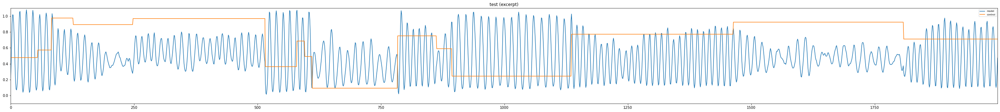

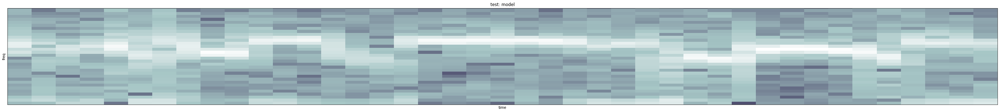

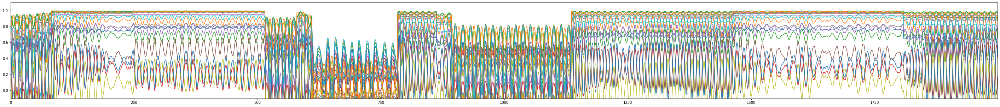

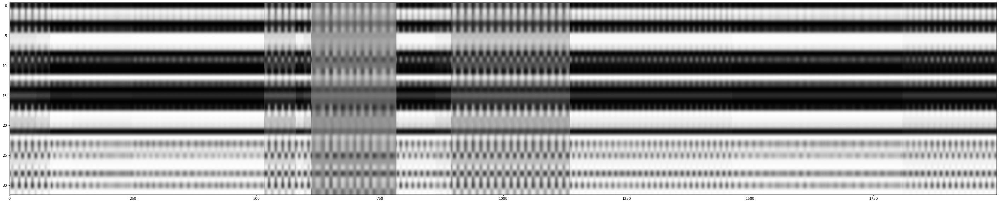

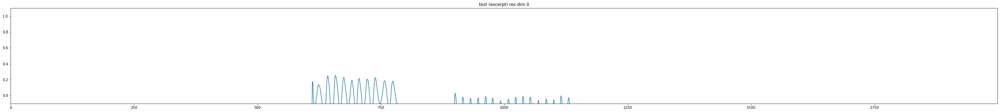

...

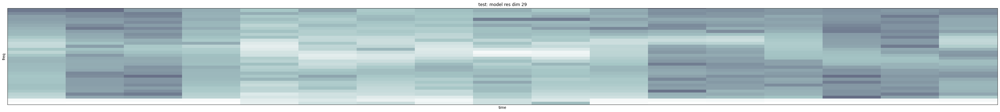

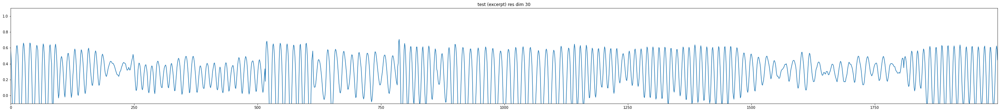

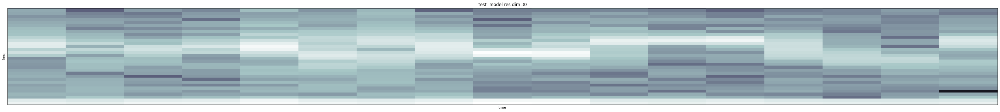

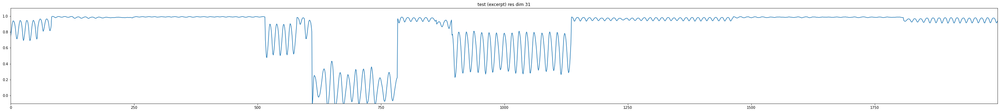

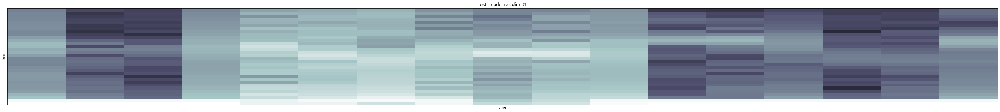

In [33]:
pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))
print("test_error")
print(test_error)
pred_states = esn.get_pred_states()

window_test = range(2000)
plt.figure(figsize=(50,5))
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1])
plt.show()

plt.figure(figsize=(50,5))
draw_spectogram(pred_test.flatten())
plt.title("test: model")

window_test = range(2000)
plt.figure(figsize=(50,5))
for i in range(pred_states.shape[1]):
    plt.plot(pred_states[window_test,i],label='{}-dim'.format(i))
#plt.legend(fontsize='x-small')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1]);
plt.show()

plt.figure(figsize=(50,10))
plt.imshow(pred_states[window_test,:].T, cmap='gray', aspect='auto')
plt.xlim([window_test[0],window_test[-1]])
plt.show()

window_test = range(2000)
for i in range(pred_states.shape[1]):
    plt.figure(figsize=(50,5))
    plt.plot(pred_states[window_test,i],label='model')
    #plt.legend(fontsize='x-small')
    plt.title('test (excerpt) res dim {}'.format(i))
    plt.xlim([window_test[0],window_test[-1]])
    plt.ylim([-0.1,1.1]);
    
    plt.figure(figsize=(50,5))
    draw_spectogram(pred_states[window_test,i].flatten())
    plt.title('test: model res dim {}'.format(i))
    
    plt.show()

test_error
0.496425286887407


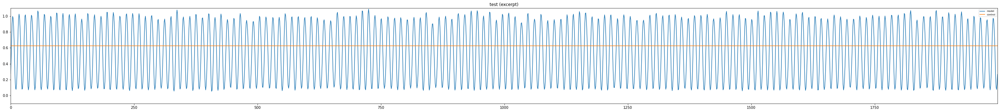

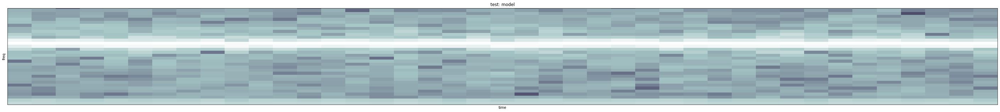

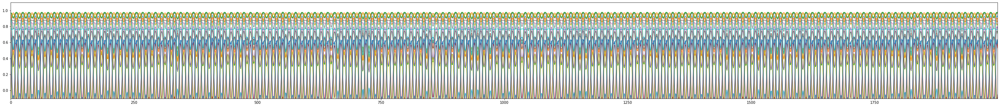

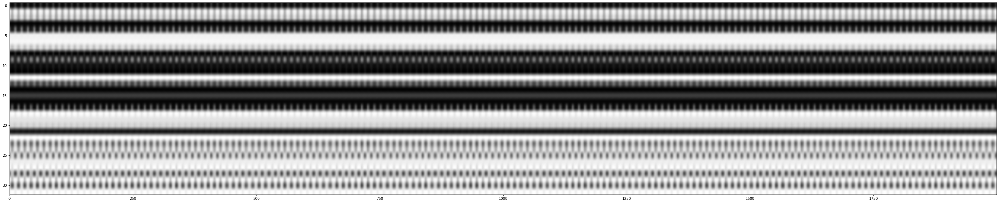

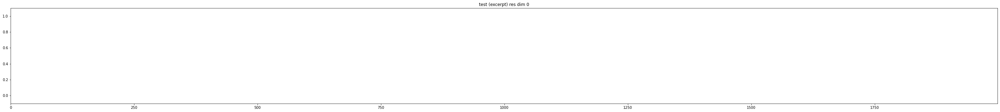

...

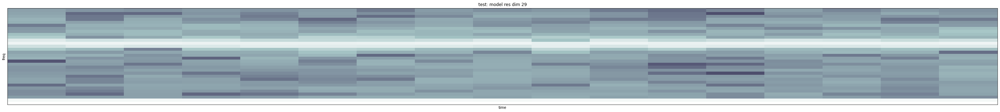

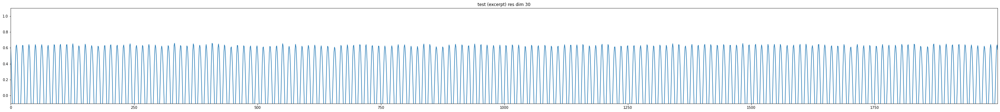

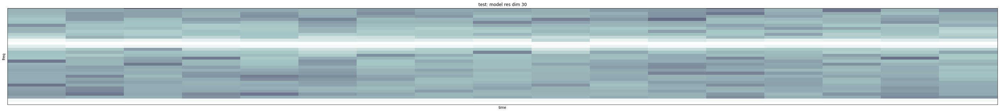

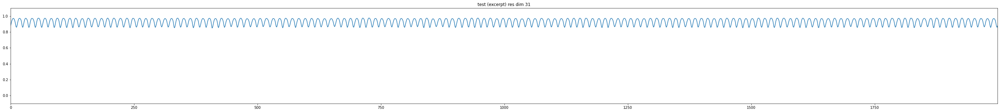

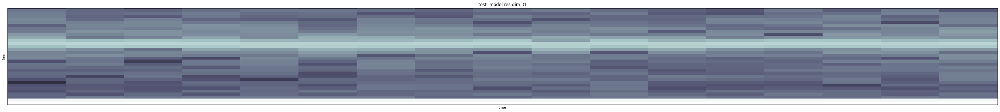

In [34]:
tmp_test_output = test_output.copy()
tmp_test_ctrl = test_ctrl.copy()
test_output = easy_test_output
test_ctrl = easy_test_ctrl

pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))
print("test_error")
print(test_error)
pred_states = esn.get_pred_states()

window_test = range(2000)
plt.figure(figsize=(50,5))
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1])
plt.show()

plt.figure(figsize=(50,5))
draw_spectogram(pred_test.flatten())
plt.title("test: model")

window_test = range(2000)
plt.figure(figsize=(50,5))
for i in range(pred_states.shape[1]):
    plt.plot(pred_states[window_test,i],label='{}-dim'.format(i))
#plt.legend(fontsize='x-small')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1]);
plt.show()

plt.figure(figsize=(50,10))
plt.imshow(pred_states[window_test,:].T, cmap='gray', aspect='auto')
plt.xlim([window_test[0],window_test[-1]])
plt.show()

window_test = range(2000)
for i in range(pred_states.shape[1]):
    plt.figure(figsize=(50,5))
    plt.plot(pred_states[window_test,i],label='model')
    #plt.legend(fontsize='x-small')
    plt.title('test (excerpt) res dim {}'.format(i))
    plt.xlim([window_test[0],window_test[-1]])
    plt.ylim([-0.1,1.1]);
    
    plt.figure(figsize=(50,5))
    draw_spectogram(pred_states[window_test,i].flatten())
    plt.title('test: model res dim {}'.format(i))
    
    plt.show()

test_output = tmp_test_output
test_ctrl = tmp_test_ctrl

'test_output = tmp_test_output\ntest_ctrl = tmp_test_ctrl'

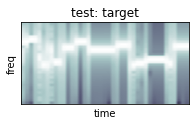

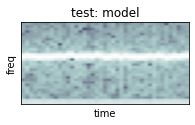

In [14]:
def draw_spectogram(data):
    plt.specgram(data,Fs=4,NFFT=256,noverlap=150,cmap=plt.cm.bone,detrend=lambda x:(x-0.5))
    plt.gca().autoscale('x')
    plt.ylim([0,0.5])
    plt.ylabel("freq")
    plt.yticks([])
    plt.xlabel("time")
    plt.xticks([])

plt.figure(figsize=(3,1.5))
draw_spectogram(pred_test.flatten())
plt.title("test: model")

test_error
0.49560681908084586


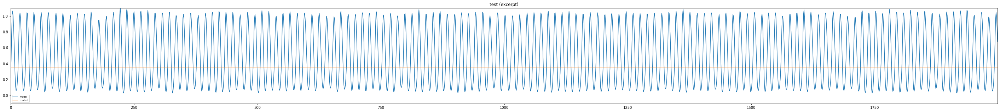

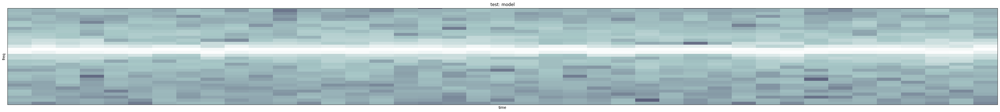

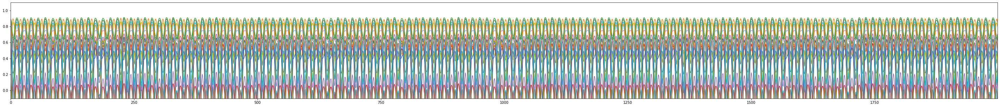

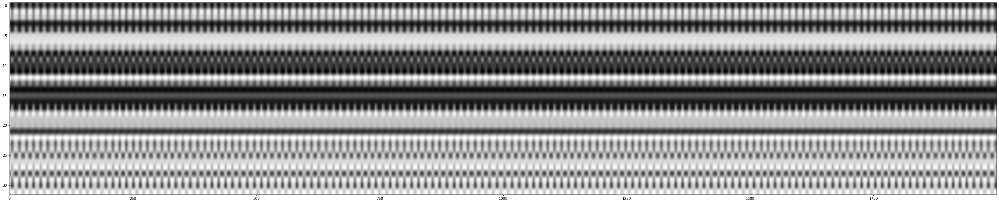

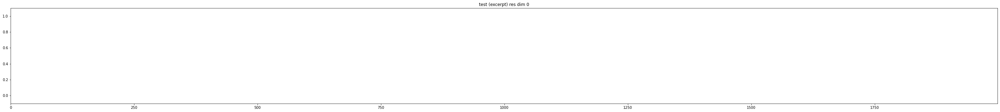

...

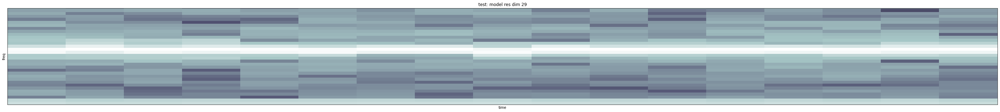

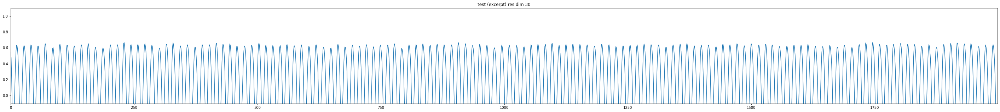

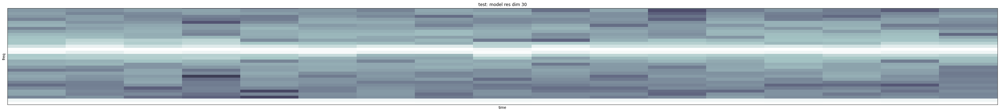

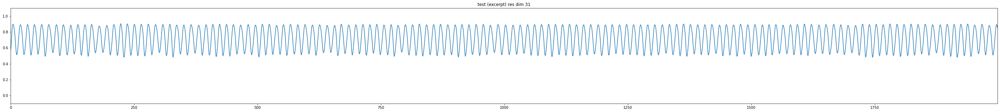

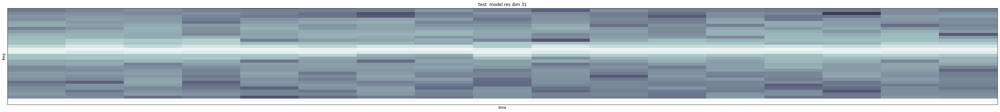

In [35]:
tmp_test_output = test_output.copy()
tmp_test_ctrl = test_ctrl.copy()
test_output = easy2_test_output
test_ctrl = easy2_test_ctrl

pred_test = esn.predict(test_ctrl)
test_error = np.sqrt(np.mean((pred_test - test_output)**2))
print("test_error")
print(test_error)
pred_states = esn.get_pred_states()

window_test = range(2000)
plt.figure(figsize=(50,5))
plt.plot(pred_test[window_test],label='model')
plt.plot(test_ctrl[window_test,1],label='control')
plt.legend(fontsize='x-small')
plt.title('test (excerpt)')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1])
plt.show()

plt.figure(figsize=(50,5))
draw_spectogram(pred_test.flatten())
plt.title("test: model")

window_test = range(2000)
plt.figure(figsize=(50,5))
for i in range(pred_states.shape[1]):
    plt.plot(pred_states[window_test,i],label='{}-dim'.format(i))
#plt.legend(fontsize='x-small')
plt.xlim([window_test[0],window_test[-1]])
plt.ylim([-0.1,1.1]);
plt.show()

plt.figure(figsize=(50,10))
plt.imshow(pred_states[window_test,:].T, cmap='gray', aspect='auto')
plt.xlim([window_test[0],window_test[-1]])
plt.show()

window_test = range(2000)
for i in range(pred_states.shape[1]):
    plt.figure(figsize=(50,5))
    plt.plot(pred_states[window_test,i],label='model')
    #plt.legend(fontsize='x-small')
    plt.title('test (excerpt) res dim {}'.format(i))
    plt.xlim([window_test[0],window_test[-1]])
    plt.ylim([-0.1,1.1]);
    
    plt.figure(figsize=(50,5))
    draw_spectogram(pred_states[window_test,i].flatten())
    plt.title('test: model res dim {}'.format(i))
    
    plt.show()

test_output = tmp_test_output
test_ctrl = tmp_test_ctrl

Text(0.5, 1.0, 'test: model')

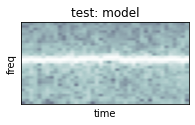

In [16]:
def draw_spectogram(data):
    plt.specgram(data,Fs=4,NFFT=256,noverlap=150,cmap=plt.cm.bone,detrend=lambda x:(x-0.5))
    plt.gca().autoscale('x')
    plt.ylim([0,0.5])
    plt.ylabel("freq")
    plt.yticks([])
    plt.xlabel("time")
    plt.xticks([])

plt.figure(figsize=(3,1.5))
draw_spectogram(pred_test.flatten())
plt.title("test: model")

What we see is that we can't see much, except that the amplitude is systematically too small (any ideas why that is?).

So let's look at a few spectrograms to see how the frequency spectrum of these signals changes over time.

It's a frequency generator!